<a href="https://colab.research.google.com/github/harshitsingh09/miniproject/blob/main/povertyPrediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Poverty Mapping

##Installing and Importing libraries

In [1]:
![ -e /content ] && pip install geopandas==0.10.2
![ -e /content ] && pip install folium==0.12.1.post1
![ -e /content ] && pip install mapclassify==2.4.3
![ -e /content ] && pip install git+https://github.com/thinkingmachines/geowrangler.git
![ -e /content ] && pip uninstall pygeos shapely -y
![ -e /content ] && pip install pygeos==0.12.0 shapely==1.8.5  --no-binary pygeos --no-binary shapely

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 7.4 MB/s eta 0:00:00
  Attempting uninstall: geopandas
    Found existing installation: geopandas 0.13.2
    Uninstalling geopandas-0.13.2:
      Successfully uninstalled geopandas-0.13.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
bigframes 1.4.0 requires geopandas>=0.12.2, but you have geopandas 0.10.2 which is incompatible.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 95.0/95.0 kB 1.7 MB/s eta 0:00:00
  Attempting uninstall: folium
    Found existing installation: folium 0.14.0
    Uninstalling folium-0.14.0:
      Successfully uninstalled folium-0.14.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
geemap 0.32.1 requires folium>=0.13.0, but you have folium 0.12.1.post1 w

In [2]:
!pip install geopandas
!pip install shapely
!pip install rtree
!pip install pygeos>=0.10.0

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.5/2.5 MB 8.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 535.2/535.2 kB 5.6 MB/s eta 0:00:00


In [3]:
from pathlib import Path

import folium
import geopandas as gpd
import matplotlib.pyplot as plt
import pandas as pd
import sklearn
from shapely import wkt
from sklearn.ensemble import RandomForestRegressor

import geowrangler.area_zonal_stats as azs
import geowrangler.distance_zonal_stats as dzs
import geowrangler.raster_zonal_stats as rzs
import geowrangler.vector_zonal_stats as vzs
from geowrangler import grids
from geowrangler.datasets import geofabrik, ookla

/usr/local/lib/python3.10/dist-packages/geopandas/_compat.py:111: UserWarning: The Shapely GEOS version (3.11.3-CAPI-1.17.3) is incompatible with the GEOS version PyGEOS was compiled with (3.10.4-CAPI-1.16.2). Conversions between both will be slow.
  warnings.warn(


Data download

In [4]:
# hide
# no_test
!mkdir -p ../data
![ -e /content ] && ln -s ../data .

In [5]:
# no_test
# download data if not yet available
![ ! -e ../data/phl_adm0.geojson ] && curl -s -o ../data/phl_adm0.geojson https://raw.githubusercontent.com/thinkingmachines/geowrangler/master/data/phl_adm0.geojson
![ ! -e ../data/phl_dhs_cluster_level.csv ] && curl -s -o ../data/phl_dhs_cluster_level.csv https://raw.githubusercontent.com/thinkingmachines/geowrangler/master/data/phl_dhs_cluster_level.csv
![ ! -e ../data/phl_ntl.tif ] && curl -s -o ../data/phl_ntl.tif https://raw.githubusercontent.com/thinkingmachines/geowrangler/master/data/phl_ntl.tif

In [6]:
DATA_DIR = Path("../data/")
# Auto-creates the folder if it does not exist
DATA_DIR.mkdir(parents=True, exist_ok=True)

Data prep

In [7]:
# Load ground truth data as a DataFrame first
GROUND_TRUTH_CSV = DATA_DIR / "phl_dhs_cluster_level.csv"
df = pd.read_csv(GROUND_TRUTH_CSV)

# Some of the coordinates in the data are invalid. This filters them out.
df = df[(df.longitude > 0) & (df.latitude > 0)]

# Create a GeoDataFrame from the longitude, latitude columns.
gdf = gpd.GeoDataFrame(
    df, geometry=gpd.points_from_xy(df.longitude, df.latitude), crs="epsg:4326"
)

print(f"There are {len(gdf):,} clusters.")
gdf.head()

There are 1,213 clusters.


,DHSCLUST,Wealth Index,DHSID,longitude,latitude,geometry
0,1,-31881.60870,PH201700000001,122.109807,6.674652,POINT (122.10981 6.67465)
1,2,-2855.37500,PH201700000002,122.132027,6.662256,POINT (122.13203 6.66226)
2,3,-57647.04762,PH201700000003,122.179496,6.621822,POINT (122.17950 6.62182)
3,4,-54952.66667,PH201700000004,122.137965,6.485298,POINT (122.13796 6.48530)
5,6,-80701.69565,PH201700000006,121.916094,6.629457,POINT (121.91609 6.62946)


In [8]:
# Make sure to convert to PH crs first for the buffer in meters, and then back to WGS84
gdf = gdf.to_crs("epsg:3123")
gdf.geometry = gdf.geometry.buffer(2000)
gdf = gdf.to_crs("epsg:4326")

gdf.head(5)

,DHSCLUST,Wealth Index,DHSID,longitude,latitude,geometry
0,1,-31881.60870,PH201700000001,122.109807,6.674652,"POLYGON ((122.12789 6.67461, 122.12780 6.67284..."
1,2,-2855.37500,PH201700000002,122.132027,6.662256,"POLYGON ((122.15011 6.66221, 122.15002 6.66044..."
2,3,-57647.04762,PH201700000003,122.179496,6.621822,"POLYGON ((122.19758 6.62178, 122.19749 6.62001..."
3,4,-54952.66667,PH201700000004,122.137965,6.485298,"POLYGON ((122.15604 6.48526, 122.15595 6.48349..."
5,6,-80701.69565,PH201700000006,121.916094,6.629457,"POLYGON ((121.93418 6.62942, 121.93409 6.62765..."


In [9]:
gdf.explore()

/usr/local/lib/python3.10/dist-packages/mapclassify/classifiers.py:511: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  def _fisher_jenks_means(values, classes=5, sort=True):


In [10]:
ookla_fixed_2019_q1_filepath = ookla.download_ookla_file(
    type_="fixed", year="2019", quarter="1"
)
# This is where the downloaded file is located.
# By default this downloads to your data/ folder, but you can customize this.
ookla_fixed_2019_q1_filepath

2024-05-09 03:06:40.552 | INFO     | geowrangler.datasets.utils:urlretrieve:26 - Retrieving https://ookla-open-data.s3.us-west-2.amazonaws.com/parquet/performance/type=fixed/year=2019/quarter=1/2019-01-01_performance_fixed_tiles.parquet into data/2019-01-01_performance_fixed_tiles.parquet


Path('data/2019-01-01_performance_fixed_tiles.parquet')

In [11]:
# This is a function to load and do some light pre-processing on the Ookla data.


def load_ookla_data(filename, mask=None):

    # Ookla's parquet file doesn't seem to have geo metadata so need to read through pandas first
    ookla_df = pd.read_parquet(filename)
    ookla_gdf = gpd.GeoDataFrame(
        ookla_df,
        geometry=ookla_df["tile"].apply(lambda x: wkt.loads(x)),
        crs="epsg:4326",
    )
    ookla_gdf.drop(columns=["tile"], inplace=True)

    # Ookla's data files contain data for the whole world.
    # For our case, we're retaining only tiles that intersect with the given mask.
    # This is to speed-up any processing we do later on.
    if mask is not None:
        keep_cols = ookla_gdf.columns
        ookla_gdf = ookla_gdf.sjoin(mask, how="inner", predicate="intersects")
        ookla_gdf = ookla_gdf[keep_cols]
        ookla_gdf.head()

    # Convert kbps to mbps for easier reading
    ookla_gdf["avg_d_mbps"] = ookla_gdf["avg_d_kbps"] / 1000
    ookla_gdf["avg_u_mbps"] = ookla_gdf["avg_u_kbps"] / 1000

    return ookla_gdf

In [12]:
%%time
ookla_gdf = load_ookla_data(ookla_fixed_2019_q1_filepath, mask=gdf)

CPU times: user 4min 35s, sys: 17.5 s, total: 4min 53s
Wall time: 4min 59s


In [13]:
print(
    f"{len(ookla_gdf):,} Ookla data tiles retained that intersect with our DHS cluster neighborhoods."
)
ookla_gdf.head()

17,245 Ookla data tiles retained that intersect with our DHS cluster neighborhoods.


,quadkey,avg_d_kbps,avg_u_kbps,avg_lat_ms,tests,devices,geometry,avg_d_mbps,avg_u_mbps
4368240,1323011210311031,10,21,126,1,1,"POLYGON ((121.96472 20.45790, 121.97021 20.457...",0.010,0.021
4368241,1323011210311033,5931,10633,228,3,2,"POLYGON ((121.96472 20.45275, 121.97021 20.452...",5.931,10.633
4368242,1323011210311122,13063,9266,218,5,2,"POLYGON ((121.97021 20.45275, 121.97571 20.452...",13.063,9.266
4368243,1323011210311211,20,51,130,1,1,"POLYGON ((121.96472 20.44760, 121.97021 20.447...",0.020,0.051
4368245,1323011210311230,195,589,114,1,1,"POLYGON ((121.95923 20.43731, 121.96472 20.437...",0.195,0.589


OSM

In [14]:
# This download can take around 1-2 minutes.
ph_osm_zip_path = geofabrik.download_geofabrik_region("philippines")

# This line unzips the zip file if we haven't done so yet.
!echo 'None' | unzip $ph_osm_zip_path -d data/ph_osm/

2024-05-09 03:11:55.313 | INFO     | geowrangler.datasets.utils:urlretrieve:26 - Retrieving https://download.geofabrik.de/asia/philippines-latest-free.shp.zip into data/philippines-latest-free.shp.zip


Archive:  data/philippines-latest-free.shp.zip
  inflating: data/ph_osm/README      
 extracting: data/ph_osm/gis_osm_buildings_a_free_1.cpg  
  inflating: data/ph_osm/gis_osm_buildings_a_free_1.dbf  
  inflating: data/ph_osm/gis_osm_buildings_a_free_1.prj  
  inflating: data/ph_osm/gis_osm_buildings_a_free_1.shp  
  inflating: data/ph_osm/gis_osm_buildings_a_free_1.shx  
 extracting: data/ph_osm/gis_osm_landuse_a_free_1.cpg  
  inflating: data/ph_osm/gis_osm_landuse_a_free_1.dbf  
  inflating: data/ph_osm/gis_osm_landuse_a_free_1.prj  
  inflating: data/ph_osm/gis_osm_landuse_a_free_1.shp  
  inflating: data/ph_osm/gis_osm_landuse_a_free_1.shx  
 extracting: data/ph_osm/gis_osm_natural_a_free_1.cpg  
  inflating: data/ph_osm/gis_osm_natural_a_free_1.dbf  
  inflating: data/ph_osm/gis_osm_natural_a_free_1.prj  
  inflating: data/ph_osm/gis_osm_natural_a_free_1.shp  
  inflating: data/ph_osm/gis_osm_natural_a_free_1.shx  
 extracting: data/ph_osm/gis_osm_natural_free_1.cpg  
  inflating

In [15]:
# Uncomment the ff line to see all the available OSM files aside from POIs.
# !ls data/ph_osm

In [16]:
ph_osm_pois_filepath = "data/ph_osm/gis_osm_pois_free_1.shp"
ph_osm = gpd.read_file(ph_osm_pois_filepath)

In [17]:
print(f"There are {len(ph_osm)} OSM POIs.")
ph_osm.head()

There are 147256 OSM POIs.


,osm_id,code,fclass,name,geometry
0,21717820,2907,camera_surveillance,None,POINT (121.02120 14.57608)
1,21717872,2722,museum,Ayala Museum,POINT (121.02324 14.55358)
2,24078959,2907,camera_surveillance,None,POINT (121.05945 14.60098)
3,24797511,2542,bicycle_shop,Christine Sports Cycle Marketing,POINT (120.99506 14.55224)
4,24797535,2518,beverages,G and K wine,POINT (120.99267 14.55285)


Feature engg

In [18]:
# We'll make a copy of the GDF to avoid overwriting the original DHS GeoDataFrame.
gdf_with_features = gdf.copy()

OSM

In [19]:
# Uncomment the ff. line if you want to see the different POI classes available
# ph_osm.fclass.sort_values().unique()

In [20]:
def generate_osm_features(aoi, osm, metric_crs="epsg:3123"):

    aoi = aoi.copy()

    # GeoWrangler: Count number of all POIs per tile
    aoi = vzs.create_zonal_stats(
        aoi,
        osm,
        overlap_method="intersects",
        aggregations=[{"func": "count", "output": "poi_count", "fillna": True}],
    )

    # Count specific aoi types
    poi_types = ["restaurant", "school", "bank", "supermarket", "mall", "atm"]

    for poi_type in poi_types:
        # GeoWrangler: Count with vector zonal stats
        aoi = vzs.create_zonal_stats(
            aoi,
            osm[osm["fclass"] == poi_type],
            overlap_method="intersects",
            aggregations=[
                {"func": "count", "output": f"{poi_type}_count", "fillna": True}
            ],
        )

        # GeoWrangler: Distance with distance zonal stats
        col_name = f"{poi_type}_nearest"
        aoi = dzs.create_distance_zonal_stats(
            aoi.to_crs(metric_crs),
            osm[osm["fclass"] == poi_type].to_crs(metric_crs),
            max_distance=10_000,
            aggregations=[],
            distance_col=col_name,
        ).to_crs("epsg:4326")

        # If no POI was found within the distance limit, set the distance to a really high value
        aoi[col_name] = aoi[col_name].fillna(value=999999)

    return aoi

In [21]:
%%time
gdf_with_features = generate_osm_features(gdf_with_features, ph_osm)

CPU times: user 3.87 s, sys: 22.8 ms, total: 3.9 s
Wall time: 4.1 s


In [22]:
gdf_with_features.head()

,DHSCLUST,Wealth Index,DHSID,longitude,latitude,geometry,poi_count,restaurant_count,restaurant_nearest,school_count,school_nearest,bank_count,bank_nearest,supermarket_count,supermarket_nearest,mall_count,mall_nearest,atm_count,atm_nearest
0,1,-31881.60870,PH201700000001,122.109807,6.674652,"POLYGON ((122.12789 6.67461, 122.12780 6.67284...",0.0,0.0,3152.996430,0.0,1392.503631,0.0,1764.736950,0.0,999999.0,0.0,999999.0,0.0,999999.000000
1,2,-2855.37500,PH201700000002,122.132027,6.662256,"POLYGON ((122.15011 6.66221, 122.15002 6.66044...",6.0,0.0,5788.165918,0.0,3601.132502,1.0,0.000000,0.0,999999.0,0.0,999999.0,0.0,999999.000000
2,3,-57647.04762,PH201700000003,122.179496,6.621822,"POLYGON ((122.19758 6.62178, 122.19749 6.62001...",0.0,0.0,999999.000000,0.0,642.871037,0.0,4026.300327,0.0,999999.0,0.0,999999.0,0.0,999999.000000
3,4,-54952.66667,PH201700000004,122.137965,6.485298,"POLYGON ((122.15604 6.48526, 122.15595 6.48349...",0.0,0.0,999999.000000,0.0,2287.839903,0.0,999999.000000,0.0,999999.0,0.0,999999.0,0.0,999999.000000
5,6,-80701.69565,PH201700000006,121.916094,6.629457,"POLYGON ((121.93418 6.62942, 121.93409 6.62765...",0.0,0.0,8408.925995,0.0,3930.606257,0.0,8332.324084,0.0,999999.0,0.0,999999.0,0.0,8311.332736


ookla

In [23]:
def generate_ookla_features(aoi, ookla_gdf, metric_crs="epsg:3123"):

    aoi = aoi.copy()

    orig_aoi_crs = aoi.crs
    aoi = aoi.to_crs(metric_crs)
    ookla_gdf = ookla_gdf.to_crs(metric_crs)

    # For better formatting, rename some columns
    ookla_gdf = ookla_gdf.rename(
        columns={"avg_d_mbps": "d_mbps", "avg_u_mbps": "u_mbps", "avg_lat_ms": "lat_ms"}
    )

    # GeoWrangler: Compute stats on the various columns
    aoi = azs.create_area_zonal_stats(
        aoi,
        ookla_gdf,
        aggregations=[
            # Count number of devices in the area
            dict(column="devices", func=["raw_sum"], fillna=True),
            # Get stats on the download speeds
            dict(
                column="d_mbps",
                func=["imputed_mean", "max", "min", "std"],
                fillna=[True, True, True, True],
            ),
            # Get stats on the upload speeds
            dict(
                column="u_mbps",
                func=["imputed_mean", "max", "min", "std"],
                fillna=[True, True, True, True],
            ),
        ],
        # Don't include the land area that intersected as a column
        include_intersect=False,
        # Don't set minimum values to 0 if the neighborhood's area doesn't fully intersect with Ookla tiles.
        fix_min=False,
    )

    aoi = aoi.fillna(value="0")
    aoi = aoi.to_crs(orig_aoi_crs)

    return aoi

In [24]:
%%time
gdf_with_features = generate_ookla_features(gdf_with_features, ookla_gdf)

CPU times: user 2.72 s, sys: 7.53 ms, total: 2.72 s
Wall time: 2.72 s


In [25]:
gdf_with_features.head()

,DHSCLUST,Wealth Index,DHSID,longitude,latitude,geometry,poi_count,restaurant_count,restaurant_nearest,school_count,...,atm_nearest,devices_sum,d_mbps_mean,d_mbps_max,d_mbps_min,d_mbps_std,u_mbps_mean,u_mbps_max,u_mbps_min,u_mbps_std
0,1,-31881.60870,PH201700000001,122.109807,6.674652,"POLYGON ((122.12789 6.67461, 122.12780 6.67284...",0.0,0.0,3152.996430,0.0,...,999999.000000,0.0,0.000000,0.000,0.000,0.000000,0.000000,0.000,0.000,0.000000
1,2,-2855.37500,PH201700000002,122.132027,6.662256,"POLYGON ((122.15011 6.66221, 122.15002 6.66044...",6.0,0.0,5788.165918,0.0,...,999999.000000,38.0,0.401851,14.628,2.177,4.982053,0.255031,6.867,1.866,1.753667
2,3,-57647.04762,PH201700000003,122.179496,6.621822,"POLYGON ((122.19758 6.62178, 122.19749 6.62001...",0.0,0.0,999999.000000,0.0,...,999999.000000,0.0,0.000000,0.000,0.000,0.000000,0.000000,0.000,0.000,0.000000
3,4,-54952.66667,PH201700000004,122.137965,6.485298,"POLYGON ((122.15604 6.48526, 122.15595 6.48349...",0.0,0.0,999999.000000,0.0,...,999999.000000,0.0,0.000000,0.000,0.000,0.000000,0.000000,0.000,0.000,0.000000
5,6,-80701.69565,PH201700000006,121.916094,6.629457,"POLYGON ((121.93418 6.62942, 121.93409 6.62765...",0.0,0.0,8408.925995,0.0,...,8311.332736,0.0,0.000000,0.000,0.000,0.000000,0.000000,0.000,0.000,0.000000


Night time lights

In [26]:
def generate_ntl_features(aoi, raster_path):
    aoi = aoi.copy()

    aoi = rzs.create_raster_zonal_stats(
        aoi,
        raster_path,
        aggregation=dict(
            func=["mean", "min", "max", "std"],
            column="ntl",
        ),
        extra_args=dict(nodata=0),
    )

    aoi.fillna(0, inplace=True)

    return aoi

In [27]:
%%time
gdf_with_features = generate_ntl_features(gdf_with_features, DATA_DIR / "phl_ntl.tif")

CPU times: user 5.12 s, sys: 402 ms, total: 5.53 s
Wall time: 5.94 s


In [28]:
# Visualize the clusters with the generated features
gdf_with_features.explore()

ML Training begins

In [29]:
# For convenience, store the list of features in a variable. Remove all extraneous columns.
feature_cols = gdf_with_features.drop(
    columns=["DHSCLUST", "DHSID", "Wealth Index", "longitude", "latitude", "geometry"]
).columns

# Separate data (X) and the target (y)
X = gdf_with_features[feature_cols]
y = gdf_with_features["Wealth Index"]

# Bin y into 5 buckets for stratification when splitting the dataset
cat_y = pd.cut(y, bins=5, labels=list(range(1, 6)))

# Generate train and test partitions
X_train, X_test, y_train, y_test = sklearn.model_selection.train_test_split(
    X, y, test_size=0.2, random_state=2022, stratify=cat_y
)

In [30]:
X_train.head()

,poi_count,restaurant_count,restaurant_nearest,school_count,school_nearest,bank_count,bank_nearest,supermarket_count,supermarket_nearest,mall_count,...,d_mbps_min,d_mbps_std,u_mbps_mean,u_mbps_max,u_mbps_min,u_mbps_std,ntl_mean,ntl_min,ntl_max,ntl_std
944,1.0,0.0,4332.445808,1.0,0.000000,0.0,999999.000000,0.0,5595.357740,0.0,...,0.000,0.000000,0.000000,0.000,0.000,0.000000,0.279636,0.279636,0.279636,0.000000
328,1187.0,139.0,0.000000,23.0,0.000000,70.0,0.000000,13.0,0.000000,1.0,...,8.948,6.519399,0.033496,30.564,2.496,5.933372,9.881545,4.587300,17.190298,2.768707
696,0.0,0.0,4396.530482,0.0,7331.181601,0.0,999999.000000,0.0,999999.000000,0.0,...,0.000,0.000000,0.000000,0.000,0.000,0.000000,0.000000,0.000000,0.000000,0.000000
155,2.0,0.0,352.510311,0.0,669.141767,0.0,2606.478381,0.0,2566.227871,0.0,...,1.215,31.305303,0.863634,151.303,0.106,35.998549,0.299591,0.182455,0.519110,0.125637
614,283.0,12.0,0.000000,4.0,0.000000,14.0,0.000000,8.0,0.000000,1.0,...,2.986,6.722738,0.174738,32.774,0.527,7.027801,0.335981,0.216280,0.543996,0.084581


In [31]:
y_train.head()

944    -27114.20833
328    175912.44440
696    -29987.93750
155     75826.10526
614     54849.37500
Name: Wealth Index, dtype: float64

Evaluation function

In [32]:
def evaluate(model, X_train, X_test, y_train, y_test):

    # R^2
    train_predictions = model.predict(X_train)
    print("Train R2 score:", sklearn.metrics.r2_score(y_train, train_predictions))

    test_predictions = model.predict(X_test)
    print("Test R2 score:", sklearn.metrics.r2_score(y_test, test_predictions))

    # Plot

    # Train and test predictions vs actual values
    plt.scatter(train_predictions, y_train, label="Train samples", c="#d95f02")
    plt.scatter(test_predictions, y_test, label="Test samples", c="#7570b3")

    # Identity line
    xpoints = ypoints = plt.xlim()
    plt.plot(
        xpoints, ypoints, linestyle="--", color="k", lw=3, scalex=False, scaley=False
    )

    # Labels and legends
    plt.xlabel("Predicted value")
    plt.ylabel("True value")
    plt.legend()
    plt.tight_layout()
    plt.show()

Fit and evaluate

Train R2 score: 0.922588851535431
Test R2 score: 0.6038446488408818


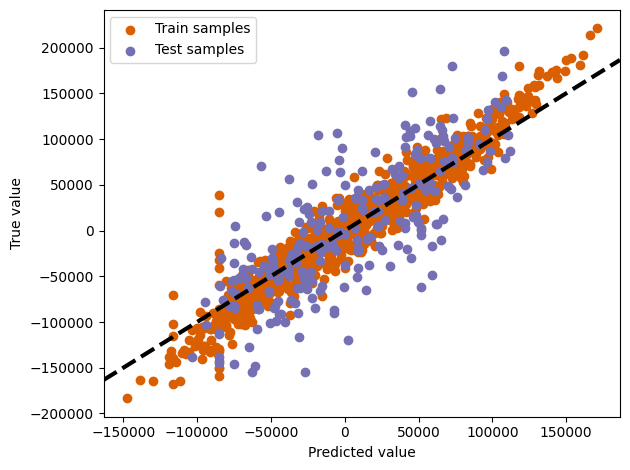

In [33]:
model = RandomForestRegressor()
model.fit(X_train, y_train)
evaluate(model, X_train, X_test, y_train, y_test)

ML rollout(phl)

In [34]:
# Read in the admin boundary for PHL.
# This file is a simplified version of the admin boundary to make the file size smaller and load times faster.
phl_adm = gpd.read_file(f"{DATA_DIR}/phl_adm0.geojson")

# Uncomment this line if you want to visualize it
# phl_adm.explore()

In [35]:
%%time
phl_tiles = grids.BingTileGridGenerator(13).generate_grid(phl_adm)
print(f"There are {len(phl_tiles):,} tiles.")
phl_tiles.head()

There are 16,257 tiles.
CPU times: user 29.6 s, sys: 42.8 ms, total: 29.6 s
Wall time: 30 s


,quadkey,geometry
0,1323230031202,"POLYGON ((119.17969 4.65308, 119.17969 4.69688..."
1,1323230030300,"POLYGON ((119.00391 4.69688, 119.00391 4.74068..."
2,1323230030311,"POLYGON ((119.13574 4.69688, 119.13574 4.74068..."
3,1323230031201,"POLYGON ((119.22363 4.69688, 119.22363 4.74068..."
4,1323212220302,"POLYGON ((118.30078 6.05316, 118.30078 6.09686..."


Feature engineering

In [36]:
phl_tiles_with_features = phl_tiles.copy()


In [37]:
%%time
phl_tiles_with_features = generate_osm_features(phl_tiles_with_features, ph_osm)

CPU times: user 3.51 s, sys: 13.6 ms, total: 3.52 s
Wall time: 3.54 s


In [38]:
%%time
phl_tiles_with_features = generate_ookla_features(phl_tiles_with_features, ookla_gdf)

CPU times: user 1.2 s, sys: 1.58 ms, total: 1.2 s
Wall time: 1.21 s


In [39]:
%%time
phl_tiles_with_features = generate_ntl_features(
    phl_tiles_with_features, f"{DATA_DIR}/phl_ntl.tif"
)

CPU times: user 1min 2s, sys: 4.57 s, total: 1min 6s
Wall time: 1min 7s


Make prediction

In [40]:
phl_tiles_with_features["predicted_wealth_index"] = model.predict(
    phl_tiles_with_features[feature_cols]
)

In [41]:
def viz_chloropleth(gdf, target_feature="predicted_wealth_index"):

    map = folium.Map(location=[14.6091, 121.0223], width=1000, height=800, zoom_start=7)
    subset = gdf.copy()
    subset["id"] = list(range(len(subset)))

    folium.Choropleth(
        geo_data=subset,
        data=subset,
        name="Wealth Predictions",
        columns=["id", target_feature],
        key_on="feature.properties.id",
        fill_color="Spectral",
        legend_name=target_feature,
    ).add_to(map)

    return map

In [42]:
# Uncomment the line below to visualize rollout
viz_chloropleth(phl_tiles_with_features)